# Assignment 3

Welcome to the assignment for week 3.

## Task 3: Hough Transform

There are two datasets available: "images/eye_tracking" and "images/lane_detection". Implement the classical Hough Transform for lines (lane detection) and circles (eye tracking) as shown in the lecture. Use any Canny Edge Detector implementation to produce edge images.

To pass this assignment, we want you to solve (Task 3.1 OR Task 3.2) AND Task 3.3. The BONUS Task 3.4 is optional as well as one of the first 2 tasks. If you are confused, just solve all of them!

In [21]:
# imports
%matplotlib inline 
import matplotlib.pyplot as plt
from skimage import io, feature, color, filters
from matplotlib.patches import Circle
from tqdm.notebook import tqdm
from skimage.draw import line
import math
import cv2
import glob
import numpy as np

In [22]:
# Plotting some samples
lane1 = io.imread('images/lane_detection/f00000.png')
lane2 = io.imread('images/lane_detection/f00050.png')
lane3 = io.imread('images/lane_detection/f00090.png')
eye1 = io.imread('images/eye_tracking/0000.jpeg')
eye2 = io.imread('images/eye_tracking/0050.jpeg')
eye3 = io.imread('images/eye_tracking/0090.jpeg')

fig = plt.figure(figsize=(20, 8))
ax11 = plt.subplot(2, 3, 1)
ax12 = plt.subplot(2, 3, 2)
ax13 = plt.subplot(2, 3, 3)
ax21 = plt.subplot(2, 3, 4)
ax22 = plt.subplot(2, 3, 5)
ax23 = plt.subplot(2, 3, 6)

ax11.imshow(lane1)
ax12.imshow(lane2)
ax13.imshow(lane3)
ax21.imshow(eye1)
ax22.imshow(eye2)
ax23.imshow(eye3)

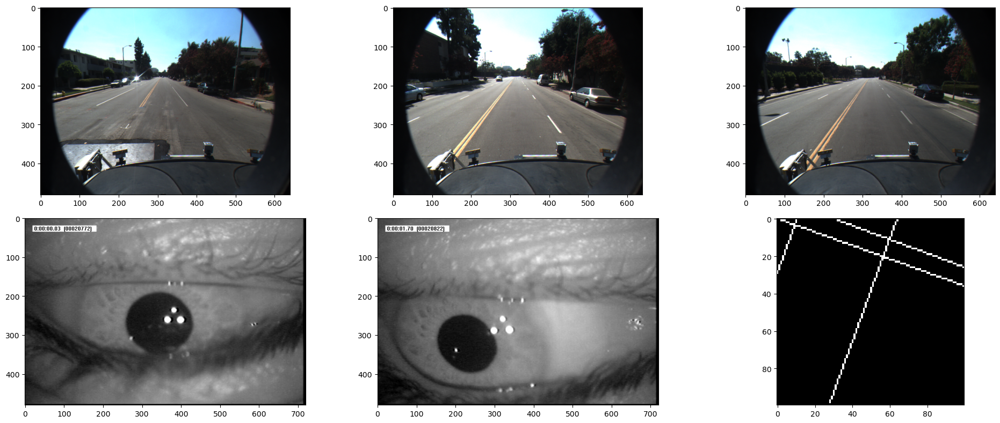

In [23]:
def draw_line_hessian_normal(image, a, r):
    
    (dimy,dimx) = image.shape

    #r = x*cosa + y*sina

    # compute start and end point of line 
    x0 = 0
    y0 = round((r - x0*math.cos(math.radians(a)))/math.sin(math.radians(a)))
    x1 = dimx
    y1 = round((r - x1*math.cos(math.radians(a)))/math.sin(math.radians(a)))

    liney,linex = line(y0,x0,y1,x1)
    
    ret = np.copy(image)
    for yy in range(0,liney.size-1):
        if (liney[yy] > 0) and (liney[yy] < dimy-1):
            ret[liney[yy],linex[yy]] = 1
    return ret

image = np.zeros((100,100))
image = draw_line_hessian_normal(image, 20, 60)
image = draw_line_hessian_normal(image, 20, 10)
image = draw_line_hessian_normal(image, 110, 0)
image = draw_line_hessian_normal(image, -70, 10)
io.imshow(image)
plt.show()

### Task 3.1: Detecting lanes

Put your Lane Detection solution here.

* Use your implementation of the Hough Transform to find the 10 strongest lines in one lane_detection image
* Display your result set (draw those lines on the image) (**RESULT**)
* Can you improve the performance by limiting the space of solutions?

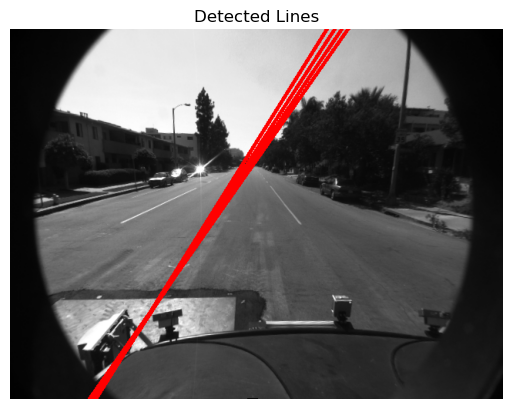

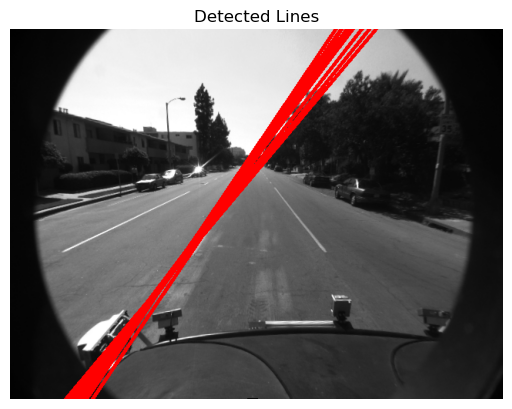

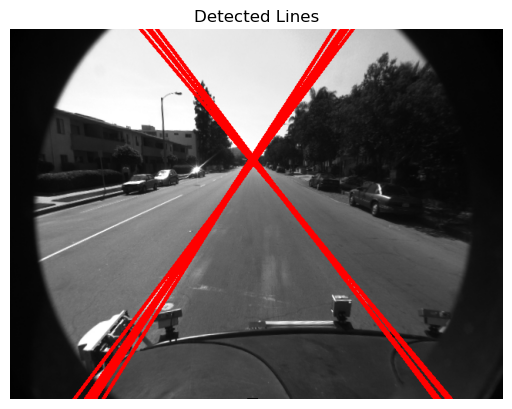

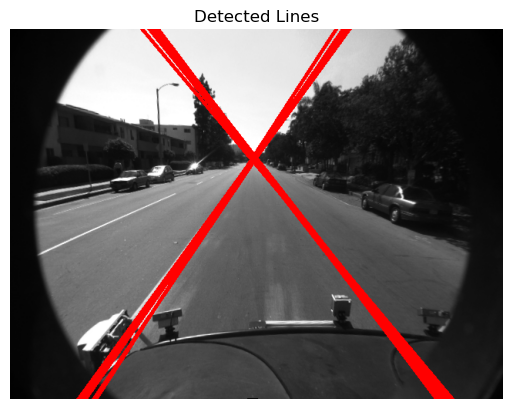

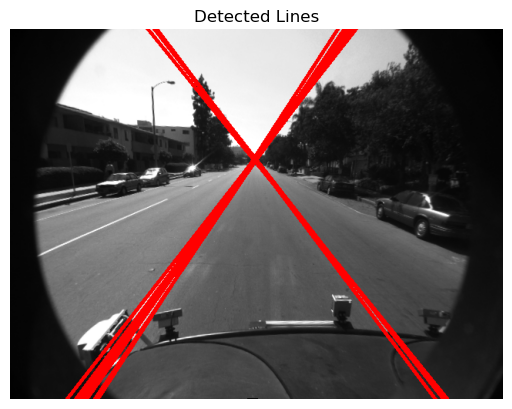

...

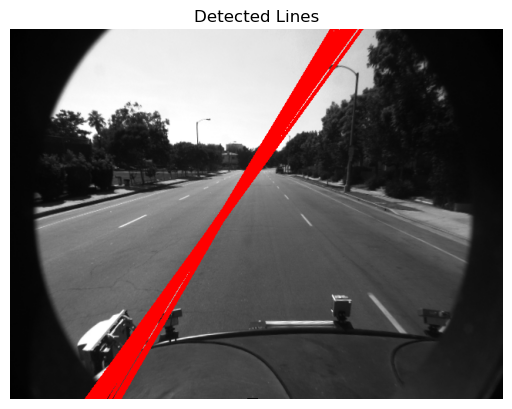

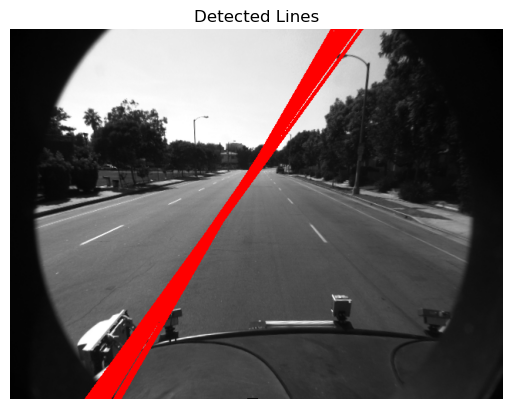

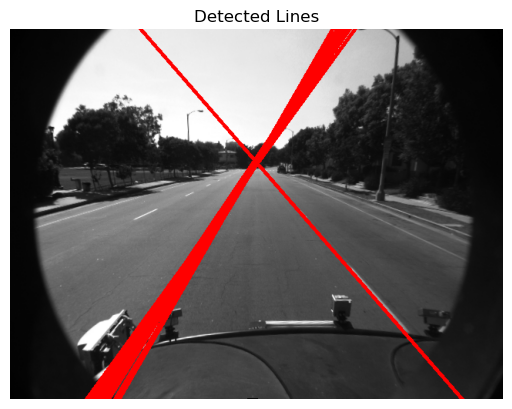

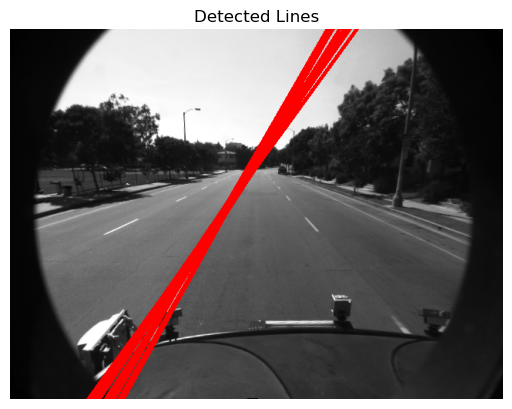

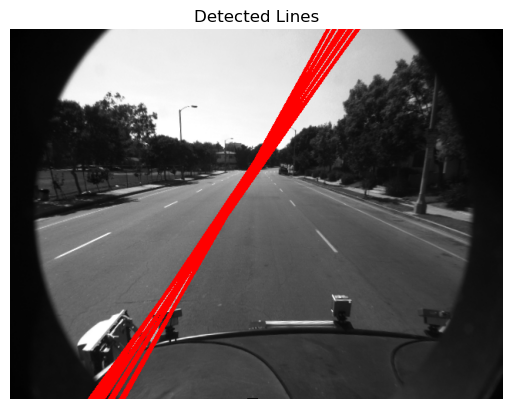

In [24]:
image_files = glob.glob('images/lane_detection/f*.png')
HORIZONTAL_THRESHOLD = 30  * np.pi / 180 
for file in image_files:
    img = cv2.imread(file, cv2.IMREAD_GRAYSCALE)
    edges = cv2.Canny(img,50,150)
    #limiting the space of solution
    mask = np.zeros_like(edges)
    height, width = edges.shape
    height, width = height, width
    cv2.rectangle(mask, (175, height // 2), (width-150, height-100), 255, thickness=-1)
    edges_roi = cv2.bitwise_and(edges, mask)
    lines = cv2.HoughLines(edges_roi, rho=1.5, theta=np.pi/180, threshold=40)
    output_image = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

    if lines is not None:
        strongest_lines = lines[:10]
        for line in strongest_lines:
            rho, theta = line[0]
            if np.abs(theta - np.pi / 2) < HORIZONTAL_THRESHOLD or np.abs(theta - 3 * np.pi / 2) < HORIZONTAL_THRESHOLD: #to filter horizontal lines
                continue
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a * rho
            y0 = b * rho
            # Line endpoints
            x1 = int(x0 + 1000 * (-b))
            y1 = int(y0 + 1000 * (a))
            x2 = int(x0 - 1000 * (-b))
            y2 = int(y0 - 1000 * (a))
            cv2.line(output_image, (x1, y1), (x2, y2), (0, 0, 255), 3)

    plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Lines')
    plt.axis('off')
    plt.show()

### Task 3.2: Eye Tracker

Put your Eye Tracker solution here.

* Use your implementation of the Hough Transform to find the 10 strongest circles in one eye_tracking sample image
* Display your result set (draw those circles on the image) (**RESULT**)
* Can you improve the performance by limiting the space of solutions?

In [25]:
# code here

### Task 3.3: Generalized Hough Transform

* Implement the Generalized Hough Transform as described in the lecture for localizing a given template
* Find the given template (see below) and mark its location in the image "animals.png" (**RESULT**)

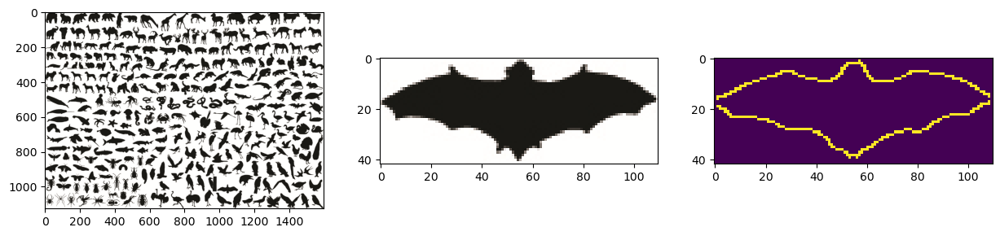

In [26]:
animals = io.imread('images/animals.png')

xmin = 1271
xmax = 1381
ymin = 519
ymax = 561

bat = animals[ymin:ymax, xmin:xmax]
bat_edge = feature.canny(color.rgb2gray(bat), 2)

fig = plt.figure(figsize=(15, 10))
ax1 = plt.subplot(1, 3, 1)
ax2 = plt.subplot(1, 3, 2)
ax3 = plt.subplot(1, 3, 3)

ax1.imshow(animals)
ax2.imshow(bat)
ax3.imshow(bat_edge)
plt.show()

In [27]:
NUM_BINS=10
DEGREE_MAX = 360

points = np.column_stack(np.where(bat_edge))

y_center, x_center = np.mean(points, axis=0)


bat_grey =  color.rgb2gray(bat)
sobel_h = filters.sobel_h(bat_grey)
sobel_v = filters.sobel_v(bat_grey)
gradient_direction = np.arctan2(sobel_v, sobel_h)

gradient_direction_points = (np.degrees(gradient_direction[points[:, 0], points[:, 1]]) + 360) % 360


vectors = np.array([[y_center-y, x_center-x] for y, x in points]).astype(int)


# Shape (NUM_BINS, x)
bins = [[] for i in range(NUM_BINS)]

for idx in range(NUM_BINS):
    deg_floor = np.floor(DEGREE_MAX/NUM_BINS * (idx))
    deg_ceiling = np.ceil(DEGREE_MAX/NUM_BINS * (idx+1))
    bins[idx] = np.array([vect for i, vect in enumerate(vectors) if deg_floor < gradient_direction_points[i] <= deg_ceiling])




In [28]:
# Accumulator
# Loop through all points

all_edges = feature.canny(color.rgb2gray(animals), 2)
all_points = np.column_stack(np.where(all_edges))


all_grey =  color.rgb2gray(animals)
sobel_h = filters.sobel_h(all_grey)
sobel_v = filters.sobel_v(all_grey)
gradient_direction = np.arctan2(sobel_v, sobel_h)

gradient_direction_points = (np.degrees(gradient_direction[all_points[:, 0], all_points[:, 1]]) + 360) % 360




#accumulator = [[0] * len(l) for l in animals]
accumulator = np.zeros_like(animals)



In [29]:

for i,point in enumerate(all_points):
    for idx in range(NUM_BINS):
        deg_floor = np.floor(DEGREE_MAX/NUM_BINS * (idx))
        deg_ceiling = np.ceil(DEGREE_MAX/NUM_BINS * (idx+1))
        if (deg_floor < gradient_direction_points[i] <= deg_ceiling):
            new_point = bins[idx] + point
    for position in new_point:
        y, x = int(position[0]), int(position[1])
        if y < accumulator.shape[0] and x < accumulator.shape[1]:
            accumulator[position[0]] [position[1]] += 1
x = np.argmax(accumulator)  # x is most common centroid -> mark in picture
pass

max_position = np.unravel_index(x, accumulator.shape)


# Extract the coordinates
#row, col = max_position

#print(f"The most common centroid is at: row={row}, column={col}")

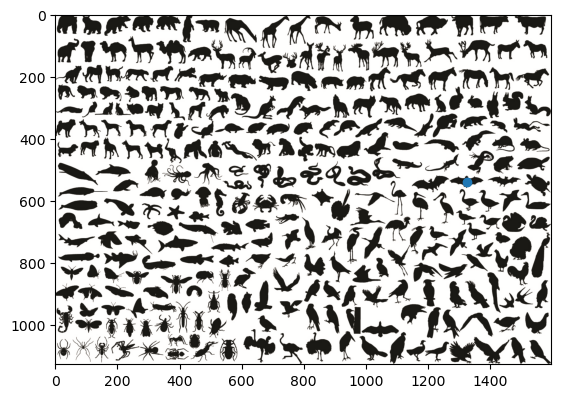

In [30]:
plt.imshow(animals)
plt.scatter(max_position[1], max_position[0])
plt.show()

### Task 3.4 (BONUS) 
* Implement an extended version of the GHT that find scaled and rotated variants of the template
* Find Italy (see "italy.jpg") and the map of Europe ("europe_map_political.jpg")
* Note that you can binarize your italy template by using a simple color lookup
* Draw the location of italy on the map and print its scale and rotation (**BONUS**)

In [31]:
# code here

## Congratz, you made it! :)